<div class="usecase-title">Public Transport Demand </div>

<div class="usecase-authors"><b>Authored by: </b> Taehwan Jung</div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>
    <div class="usecase-level"><b>Level:</b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite skills: </b>Python, Haversine distance, Folium</div>
    

**Scenario** 

According to Melbourne's Transport Strategy 2030, there are plans to expand the role of public transport. This strategy aims to enhance transport capacity and improve urban mobility through investments in public transport infrastructure. In alignment with this plan, the project focuses on analyzing pedestrian data in conjunction with train station and bus stop locations to estimate public transport demand in specific areas and evaluate service efficiency. By identifying patterns in pedestrian activity and correlating them with high-demand areas and times, the project seeks to better understand how well current services align with actual demand. Insights from this analysis will support the city's goals for future growth and sustainability of public transport as outlined in the 2030 Strategy.

**User story**

As a public transportation planner, I want to understand which areas have the highest pedestrian demand for public trasport so that I can collect resources effectively and plan additional services where needed.


**At the end of this use case you will:**
- learn how to load datasets using APIs
- learn how to analyze data using linear regression and random forest techniques
- learn how to create maps, plots, and bar charts

**Datasets**

**1. Pedestrian Counting per Hour:**
Contains hourly data on the number of pedestrians counted at various sensor locations throughout Melbourne, including sensor IDs, timestamps, and location details.

**2. Bus Stops:** 
shows the locations of the bus stops within the city of Melbourne, As the city of Melbourne do not run the bus services, this is simply to show the locations of the stops, this data does not include the services that run from each of the stops.

**3. Metro train stations with accessbility information:** 
contains locations of train stations and their accessibility information, such as hearing aid information.

## Required modules

In [9]:
import requests
import pandas as pd
import numpy as np
from io import StringIO
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import geopandas as gpd
from folium.plugins import MarkerCluster
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from imblearn.over_sampling import SMOTE
import warnings
warnings.filterwarnings('ignore')

## Data loading

In [11]:
# Collect_data function
def collect_data(dataset_id):
    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    dataset_id = dataset_id
    format = 'csv'


    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,
        'lang': 'en',
        'timezone': 'UTC',
    }

    response = requests.get(url, params=params)


    if response.status_code == 200:
        url_content = response.content.decode('utf-8')
        dataset = pd.read_csv(StringIO(url_content), delimiter=';')
        return dataset
    else:
        print(f'Request failed with status code {response.status_code}')

Data1(Pedestrian counting) loading 

In [13]:
# Pedestrian counting data
dataset_id = 'pedestrian-counting-system-monthly-counts-per-hour'
data_1 = collect_data(dataset_id)
data_1.shape

(2033194, 9)

Data2(Bus stops) loading

In [15]:
# Bus stops data
dataset_id_2 = 'bus-stops'
data_2 = collect_data(dataset_id_2)
data_2.shape

(309, 16)

Data3(Train stops) loading 

In [17]:
# Train stations with accessibility data
dataset_id_3 = 'metro-train-stations-with-accessibility-information'
data_3 = collect_data(dataset_id_3)
data_3.shape

(219, 6)

## Data preprocessing

In [19]:
# Pedestrian dataset
data_1.isna().sum()

id                 0
location_id        0
sensing_date       0
hourday            0
direction_1        0
direction_2        0
pedestriancount    0
sensor_name        0
location           0
dtype: int64

In [20]:
# Bus stops dataset
data_2.isna().sum()

geo_point_2d      0
geo_shape         0
prop_id           0
addresspt1        0
addressp_1        0
asset_clas        0
asset_type        0
objectid          0
str_id            0
addresspt         0
asset_subt      309
model_desc        0
mcc_id            0
roadseg_id        0
descriptio        0
model_no          0
dtype: int64

In [21]:
# Train staions dataset
data_3.isna().sum()

geo_point_2d    0
geo_shape       0
he_loop         0
lift            0
pids            0
station         0
dtype: int64

Check for missing values in the three datasets

In [23]:
# Remove unecessary column
data_2.drop(columns=['asset_subt'], inplace=True)

Remove column with many missing values 

In [25]:
# From object type to pandast datetime type 
data_1['sensing_date'] = pd.to_datetime(data_1['sensing_date'])

# Check the data type
print(data_1['sensing_date'].dtypes)

datetime64[ns]


Convert the 'Sensing_Date' column in the pedestrian dataset to Pandas datetime format

In [27]:
# Create columns of 'latitude'and 'longitude' 
# Data_1
data_1[['latitude', 'longitude']] = data_1['location'].str.split(',', expand=True)
data_1['latitude'] = pd.to_numeric(data_1['latitude'], errors='coerce')
data_1['longitude'] = pd.to_numeric(data_1['longitude'], errors='coerce')

# Data_2
data_2[['latitude', 'longitude']] = data_2['geo_point_2d'].str.split(',', expand=True)
data_2['latitude'] = pd.to_numeric(data_2['latitude'], errors='coerce')
data_2['longitude'] = pd.to_numeric(data_2['longitude'], errors='coerce')

# Data_3
data_3[['latitude', 'longitude']] = data_3['geo_point_2d'].str.split(',', expand=True)
data_3['latitude'] = pd.to_numeric(data_3['latitude'], errors='coerce')
data_3['longitude'] = pd.to_numeric(data_3['longitude'], errors='coerce')

Convert the 'location' columns to 'latitude' and 'longitude' in each dataset 

In [29]:
# Aggregaring 'pedestriancount' column of data_1 (pedestrian data) 
data_1_1 = data_1
data_1_1['year_month_day'] = data_1['sensing_date'].dt.to_period('D').dt.end_time.dt.date

# Aggregating 'pedestriancount' daily  
data_1_daily = data_1_1.groupby(['sensor_name','location_id', 'year_month_day', 'location','latitude','longitude']).agg({
    'pedestriancount': 'sum'
}).reset_index()
data_1_daily.head()

,sensor_name,location_id,year_month_day,location,latitude,longitude,pedestriancount
0,261Will_T,108,2022-11-17,"-37.81295822, 144.95678789",-37.812958,144.956788,3993
1,261Will_T,108,2022-11-18,"-37.81295822, 144.95678789",-37.812958,144.956788,11594
2,261Will_T,108,2022-11-19,"-37.81295822, 144.95678789",-37.812958,144.956788,3200
3,261Will_T,108,2022-11-20,"-37.81295822, 144.95678789",-37.812958,144.956788,2855
4,261Will_T,108,2022-11-21,"-37.81295822, 144.95678789",-37.812958,144.956788,11506


Aggregate the pedestrian data daily by summing the 'pedestriancount' column

In [31]:
# Filtering necessary columns
data_1_hourly = data_1_1[['sensor_name','year_month_day', 'location_id', 'hourday', 'location', 'pedestriancount','latitude','longitude']]

# Sorting by sensor_name
data_1_hourly = data_1_hourly.sort_values(by=['sensor_name','year_month_day','hourday','latitude','longitude']).reset_index(drop=True)

# Check result
data_1_hourly.head(10)

,sensor_name,year_month_day,location_id,hourday,location,pedestriancount,latitude,longitude
0,261Will_T,2022-11-17,108,16,"-37.81295822, 144.95678789",312,-37.812958,144.956788
1,261Will_T,2022-11-17,108,17,"-37.81295822, 144.95678789",1692,-37.812958,144.956788
2,261Will_T,2022-11-17,108,18,"-37.81295822, 144.95678789",758,-37.812958,144.956788
3,261Will_T,2022-11-17,108,19,"-37.81295822, 144.95678789",436,-37.812958,144.956788
4,261Will_T,2022-11-17,108,20,"-37.81295822, 144.95678789",264,-37.812958,144.956788
5,261Will_T,2022-11-17,108,21,"-37.81295822, 144.95678789",228,-37.812958,144.956788
6,261Will_T,2022-11-17,108,22,"-37.81295822, 144.95678789",218,-37.812958,144.956788
7,261Will_T,2022-11-17,108,23,"-37.81295822, 144.95678789",85,-37.812958,144.956788
8,261Will_T,2022-11-18,108,0,"-37.81295822, 144.95678789",55,-37.812958,144.956788
9,261Will_T,2022-11-18,108,1,"-37.81295822, 144.95678789",36,-37.812958,144.956788


Select only the necessary columns from the pedestrian data

In [33]:
# Filtering 2022 data
data_1_hourly_2022 = data_1_1[
    (pd.to_datetime(data_1_1['year_month_day']).dt.year == 2022) &
    (pd.to_datetime(data_1_1['year_month_day']).dt.month == 12) 
][['sensor_name', 'year_month_day', 'location_id', 'hourday', 'location', 'pedestriancount', 'latitude', 'longitude']]

# Result
print(data_1_hourly_2022.info)

<bound method DataFrame.info of         sensor_name year_month_day  location_id  hourday  \
47         KenMac_T     2022-12-31           76       23   
76             AG_T     2022-12-10           29        8   
106         SwaCs_T     2022-12-07           65        1   
177        488Mac_T     2022-12-14           85       22   
211         FliSS_T     2022-12-09           79       17   
...             ...            ...          ...      ...   
2033050    Lat224_T     2022-12-15           62       23   
2033094      ACMI_T     2022-12-29           72       23   
2033136    Swa295_T     2022-12-09            3       18   
2033140      QVMQ_T     2022-12-20           48        5   
2033164      ElFi_T     2022-12-12           84        9   

                           location  pedestriancount   latitude   longitude  
47       -37.79453803, 144.93036194               73 -37.794538  144.930362  
76        -37.8199817, 144.96872865              222 -37.819982  144.968729  
106       -37

Filter only the data from December 2022

In [35]:
# Filtering to visualize sensor location only
data_1_map = data_1.drop_duplicates(subset='sensor_name')

Create a new dataframe for visualization by removing duplicate locations from pedestrian sensor data

In [37]:
# Matching sensors within 200 metres to the bus stops
# Haversine 
def haversine(lat1, lon1, lat2, lon2):
    R = 6371.0  
    phi1 = np.radians(lat1)
    phi2 = np.radians(lat2)
    delta_phi = np.radians(lat2 - lat1)
    delta_lambda = np.radians(lon2 - lon1)

    a = np.sin(delta_phi / 2.0) ** 2 + np.cos(phi1) * np.cos(phi2) * np.sin(delta_lambda / 2.0) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    return R * c

# Sensor matching function
def match_sensors_to_data2(hourly_data, data2, radius_km=0.2):
    matches = []

    for _, sensor_row in data2.iterrows():
        data2_lat, data2_lon = sensor_row['latitude'], sensor_row['longitude']
        str_id = sensor_row['str_id']

        
        nearby_sensors = []

        for _, ped_sensor_row in hourly_data.iterrows():
            ped_lat, ped_lon = ped_sensor_row['latitude'], ped_sensor_row['longitude']
            distance = haversine(data2_lat, data2_lon, ped_lat, ped_lon)

            if distance <= radius_km:
                nearby_sensors.append({
                    'sensor_name': ped_sensor_row['sensor_name'],
                    'sensor_latitude': ped_lat,
                    'sensor_longitude': ped_lon,
                    'distance_km': distance,
                    'pedestrian_count': ped_sensor_row['pedestriancount'],
                    'year_month_day': ped_sensor_row['year_month_day'],
                    'hourday': ped_sensor_row['hourday']
                })

        
        matches.append({
            'str_id': str_id,
            'data2_latitude': data2_lat,
            'data2_longitude': data2_lon,
            'nearby_sensors': nearby_sensors
        })

    return matches

# Result dataframe
def flatten_matches(matches):
    flattened = []

    for match in matches:
        str_id = match['str_id']
        data2_lat = match['data2_latitude']
        data2_lon = match['data2_longitude']
        
        for sensor in match['nearby_sensors']:
            flattened.append({
                'str_id': str_id,
                'data2_latitude': data2_lat,
                'data2_longitude': data2_lon,
                'sensor_name': sensor['sensor_name'],
                'sensor_latitude': sensor['sensor_latitude'],
                'sensor_longitude': sensor['sensor_longitude'],
                'distance_km': sensor['distance_km'],
                'pedestrian_count': sensor['pedestrian_count'],
                'year_month_day': sensor['year_month_day'],
                'hourday': sensor['hourday']
            })

    return pd.DataFrame(flattened)

# Results
matches_1 = match_sensors_to_data2(data_1_hourly_2022, data_2)
matched_bus = flatten_matches(matches_1)
print(matched_bus)

        str_id  data2_latitude  data2_longitude sensor_name  sensor_latitude  \
0      1237092      -37.813539       144.957283   280Will_T       -37.812463   
1      1237092      -37.813539       144.957283   280Will_T       -37.812463   
2      1237092      -37.813539       144.957283   261Will_T       -37.812958   
3      1237092      -37.813539       144.957283   280Will_T       -37.812463   
4      1237092      -37.813539       144.957283   261Will_T       -37.812958   
...        ...             ...              ...         ...              ...   
69542  1240744      -37.798985       144.967339    Lyg309_T       -37.798082   
69543  1240744      -37.798985       144.967339    Lyg309_T       -37.798082   
69544  1240744      -37.798985       144.967339    Lyg309_T       -37.798082   
69545  1240744      -37.798985       144.967339    Lyg309_T       -37.798082   
69546  1240744      -37.798985       144.967339    Lyg309_T       -37.798082   

       sensor_longitude  distance_km  p

Match pedestrian sensor data within 200 metres of bus stops using the Haversine formula (to extract public transport users from the pedestrian data)

In [39]:
# Matching sensors within 200 metres to the station
# Haversine 
def haversine(lat1, lon1, lat2, lon2):
    R = 6371.0  
    phi1 = np.radians(lat1)
    phi2 = np.radians(lat2)
    delta_phi = np.radians(lat2 - lat1)
    delta_lambda = np.radians(lon2 - lon1)

    a = np.sin(delta_phi / 2.0) ** 2 + np.cos(phi1) * np.cos(phi2) * np.sin(delta_lambda / 2.0) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    return R * c

# Sensor matching function
def match_sensors_to_stations(hourly_data, station_data, radius_km=0.2):
    matches = []

    for _, station_row in station_data.iterrows():
        station_lat, station_lon = station_row['latitude'], station_row['longitude']
        station_name = station_row['station']

        
        nearby_sensors = []

        for _, sensor_row in hourly_data.iterrows():
            sensor_lat, sensor_lon = sensor_row['latitude'], sensor_row['longitude']
            distance = haversine(station_lat, station_lon, sensor_lat, sensor_lon)

            if distance <= radius_km:
                nearby_sensors.append({
                    'sensor_name': sensor_row['sensor_name'],
                    'sensor_latitude': sensor_lat,
                    'sensor_longitude': sensor_lon,
                    'distance_km': distance,
                    'pedestrian_count': sensor_row['pedestriancount'],
                    'year_month_day': sensor_row['year_month_day'],
                    'hourday': sensor_row['hourday']
                })

        
        matches.append({
            'station_name': station_name,
            'station_latitude': station_lat,
            'station_longitude': station_lon,
            'nearby_sensors': nearby_sensors
        })

    return matches

# Result dataframe
def flatten_matches(matches):
    flattened = []

    for match in matches:
        station_name = match['station_name']
        station_lat = match['station_latitude']
        station_lon = match['station_longitude']
        
        for sensor in match['nearby_sensors']:
            flattened.append({
                'station_name': station_name,
                'station_latitude': station_lat,
                'station_longitude': station_lon,
                'sensor_name': sensor['sensor_name'],
                'sensor_latitude': sensor['sensor_latitude'],
                'sensor_longitude': sensor['sensor_longitude'],
                'distance_km': sensor['distance_km'],
                'pedestrian_count': sensor['pedestrian_count'],
                'year_month_day': sensor['year_month_day'],
                'hourday': sensor['hourday']
            })

    return pd.DataFrame(flattened)

# Results
matches_2 = match_sensors_to_stations(data_1_hourly_2022, data_3)
matched_train = flatten_matches(matches_2)
print(matched_train)

          station_name  station_latitude  station_longitude sensor_name  \
0      Flinders Street        -37.818321         144.966997     FliSS_T   
1      Flinders Street        -37.818321         144.966997     FliSS_T   
2      Flinders Street        -37.818321         144.966997       Swa31   
3      Flinders Street        -37.818321         144.966997      ElFi_T   
4      Flinders Street        -37.818321         144.966997    FLDegS_T   
...                ...               ...                ...         ...   
13414        Flagstaff        -37.811827         144.956447   280Will_T   
13415        Flagstaff        -37.811827         144.956447   LatWill_T   
13416        Flagstaff        -37.811827         144.956447   280Will_T   
13417        Flagstaff        -37.811827         144.956447   LatWill_T   
13418        Flagstaff        -37.811827         144.956447   280Will_T   

       sensor_latitude  sensor_longitude  distance_km  pedestrian_count  \
0           -37.817940  

Match pedestrian sensor data within 200 metres of train stations using the Haversine formula (to extract public transport users from the pedestrian data)

## Data visualization

In [42]:
# Creating a map providing the location information of the three datasets

map_melbourne = folium.Map(location=[-37.80841814,144.95906317], zoom_start=14, width=1000, height=600, control_scale=True)
# Pedestrian data
for index, row in data_1_map.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=f"Location: {row['sensor_name']}<br>Count: {row['pedestriancount']}",
    ).add_to(map_melbourne)

# Train station data
for index, row in data_2.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6,
        popup=f"Location: {row['objectid']}",
    ).add_to(map_melbourne)

# Bus stop data
for index, row in data_3.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='green',
        fill=True,
        fill_color='green',
        fill_opacity=0.6,
        popup=f"Location: {row['station']}",
    ).add_to(map_melbourne)

# Adding a legend
legend_html = '''
<div style="position: fixed;
     top: 10px; left: 10px; width: 150px; height: 90px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white; padding: 10px;">
     <b>Legend</b><br>
     <i style="color:blue;" class="fa fa-circle"></i> Ped sensors<br>
     <i style="color:red;" class="fa fa-circle"></i> Bus stops<br>
     <i style="color:green;" class="fa fa-circle"></i> Train stations</div>
'''
map_melbourne.get_root().html.add_child(folium.Element(legend_html))

# Map displaying
map_melbourne.save('melbourne_map.html')
display(map_melbourne)

The map above shows all the locations of pedestrian sensors(blue), bus stops(red), train stations(green) 

In [123]:
# Creating a map providing the location information of the pedestrian sensors located within 200 meter of bus stops
map_melbourne_1 = folium.Map(location=[-37.80841814, 144.95906317], zoom_start=14, width=1000, height=600, control_scale=True)

# Matching bus stops
def add_bus_stops_to_map(map_object, bus_data):
    bus_stops = bus_data[['str_id', 'data2_latitude', 'data2_longitude']].drop_duplicates()
    for _, row in bus_stops.iterrows():
        folium.CircleMarker(
            location=[row['data2_latitude'], row['data2_longitude']],
            popup=f"Bus Stop ID: {row['str_id']}",
            radius=6,
            color="red",
            fill=True,
            fill_color="red",
            fill_opacity=0.6
        ).add_to(map_object)

# Matching unique pedestrian sensors to bus stops
def add_unique_sensors_to_map(map_object, sensor_data):
    unique_sensors = sensor_data.drop_duplicates(subset=['sensor_latitude', 'sensor_longitude'])
    print(f"Number of unique sensors: {unique_sensors.shape[0]}")  
    
    for _, row in unique_sensors.iterrows():
        folium.CircleMarker(
            location=[row['sensor_latitude'], row['sensor_longitude']],
            popup=(f"Sensor: {row['sensor_name']}<br>"
                   f"Pedestrian Count: {row['pedestrian_count']}<br>"
                   f"Distance: {row['distance_km']:.2f} km<br>"
                   f"Date: {row['year_month_day']} Hour: {row['hourday']}"),
            radius=6,
            color="blue",
            fill=True,
            fill_color="blue",
            fill_opacity=0.6
        ).add_to(map_object)

# Adding a legend
legend_1_html = '''
<div style="position: fixed;
     top: 20px; left: 10px; width: 150px; height: 90px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white; padding: 10px;">
     <b>Legend</b><br>
     <i style="color:blue;" class="fa fa-circle"></i> Ped sensors<br>
     <i style="color:red;" class="fa fa-circle"></i> Bus stops</div>
'''
map_melbourne_1.get_root().html.add_child(folium.Element(legend_1_html))

# Adding data to the map
add_bus_stops_to_map(map_melbourne_1, matched_bus)
add_unique_sensors_to_map(map_melbourne_1, matched_bus)

# Map displaying
map_melbourne_1.save("map_melbourne_1.html")
display(map_melbourne_1)


Number of unique sensors: 31


The map above shows the pedestrian sensors located within 200 metres of bus stops

In [45]:
# Creating a map providing the location information of the pedestrian sensors located within 200 meter of train stations
map_melbourne_2 = folium.Map(location=[-37.80841814,144.95906317], zoom_start=14, width=1000, height=600, control_scale=True)

# Matching train stations
def add_train_stations_to_map(map_object, data):
    stations = data[['station_name', 'station_latitude', 'station_longitude']].drop_duplicates()
    for _, row in stations.iterrows():
        folium.CircleMarker(
            location=[row['station_latitude'], row['station_longitude']],
            popup=f"Station: {row['station_name']}",
            radius=6,
            color="green",
            fill=True,
            fill_color="green",
            fill_opacity=0.6
        ).add_to(map_melbourne_2)


# Matching pedestiran sensors to train staions
def add_train_sensors_to_map(map_object, train_data):
    for _, row in train_data.iterrows():
        folium.CircleMarker(
            location=[row['sensor_latitude'], row['sensor_longitude']],
            popup=(f"Train Sensor: {row['sensor_name']}<br>"
                   f"Pedestrian Count: {row['pedestrian_count']}<br>"
                   f"Distance: {row['distance_km']:.2f} km<br>"
                   f"Date: {row['year_month_day']} Hour: {row['hourday']}"),
            radius=6,
            color="blue",
            fill=True,
            fill_color="blue",
            fill_opacity=0.6
        ).add_to(map_melbourne_2)

# Adding a legend
legend_2_html = '''
<div style="position: fixed;
     top: 20px; left: 10px; width: 150px; height: 90px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white; padding: 10px;">
     <b>Legend</b><br>
     <i style="color:blue;" class="fa fa-circle"></i> Ped sensors<br>
     <i style="color:green;" class="fa fa-circle"></i> Train stations</div>
'''
map_melbourne_2.get_root().html.add_child(folium.Element(legend_2_html))


add_train_stations_to_map(map_melbourne_2, matched_train)
add_train_sensors_to_map(map_melbourne_2, matched_train)

# Map displaying
map_melbourne_2.save("map_melbourne_1.html")
display(map_melbourne_2)

The map above shows the pedestrian sensors located within 200 metres of train stations

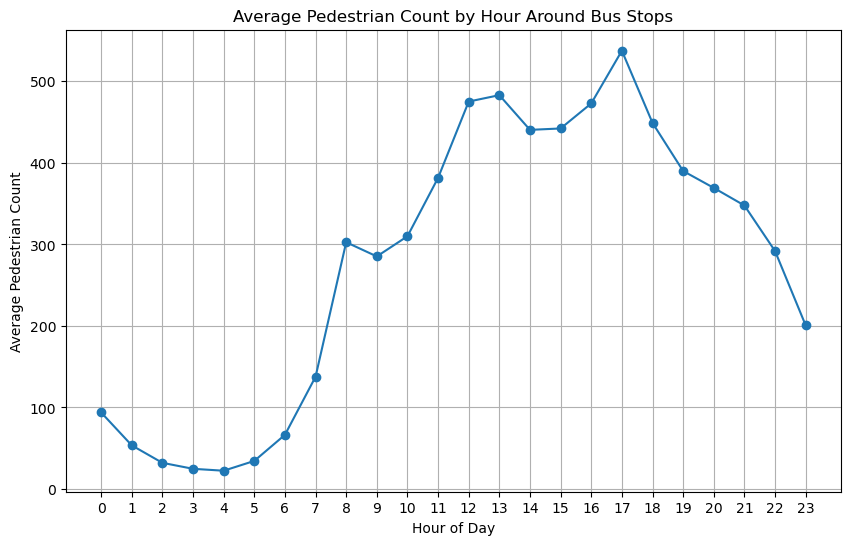

In [47]:
# Hourly average data
matched_bus_mean_hourly = matched_bus.groupby('hourday')['pedestrian_count'].mean().reset_index()

# Chart
plt.figure(figsize=(10, 6))
plt.plot(matched_bus_mean_hourly['hourday'], matched_bus_mean_hourly['pedestrian_count'], marker='o')
plt.title('Average Pedestrian Count by Hour Around Bus Stops')
plt.xlabel('Hour of Day')
plt.ylabel('Average Pedestrian Count')
plt.xticks(range(0, 24))  
plt.grid()
plt.show()

This chart illustrates the average pedestrian count recorded by sensors located within 200 metres of bus stops for each hour of the day

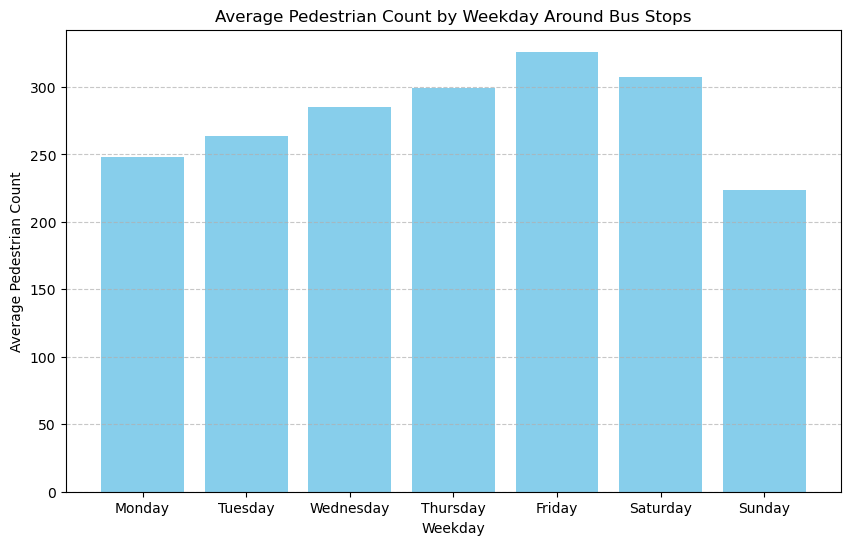

In [49]:
# Add a 'weekday' column
matched_bus['weekday'] = pd.to_datetime(matched_bus['year_month_day']).dt.day_name()

# Group data by weekend and calculate the avereage peds count
weekday_avg_bus = matched_bus.groupby('weekday')['pedestrian_count'].mean().reset_index()

# Sort weekdays
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
weekday_avg_bus['weekday'] = pd.Categorical(weekday_avg_bus['weekday'], categories=weekday_order, ordered=True)
weekday_avg_bus = weekday_avg_bus.sort_values('weekday')

# Chart
plt.figure(figsize=(10, 6))
plt.bar(weekday_avg_bus['weekday'], weekday_avg_bus['pedestrian_count'], color='skyblue')
plt.title('Average Pedestrian Count by Weekday Around Bus Stops')
plt.xlabel('Weekday')
plt.ylabel('Average Pedestrian Count')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

This chart shows the average pedestrian count recorded by sensors located within 200 metres of bus stops for each day of the week

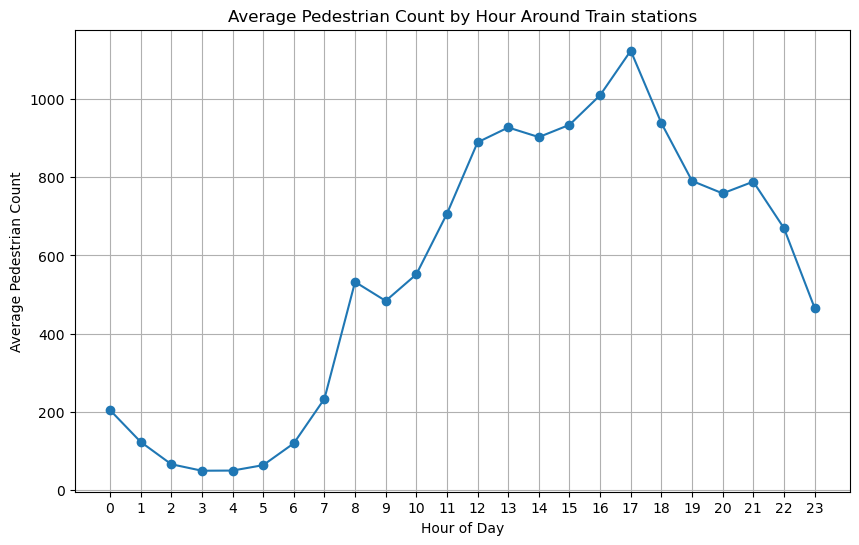

In [51]:
# Hourly average data
matched_train_mean_hourly = matched_train.groupby('hourday')['pedestrian_count'].mean().reset_index()

# Chart
plt.figure(figsize=(10, 6))
plt.plot(matched_train_mean_hourly['hourday'], matched_train_mean_hourly['pedestrian_count'], marker='o')
plt.title('Average Pedestrian Count by Hour Around Train stations')
plt.xlabel('Hour of Day')
plt.ylabel('Average Pedestrian Count')
plt.xticks(range(0, 24))  
plt.grid()
plt.show()

This chart illustrates the average pedestrian count recorded by sensors located within 200 meters of train stations for each hour of the day

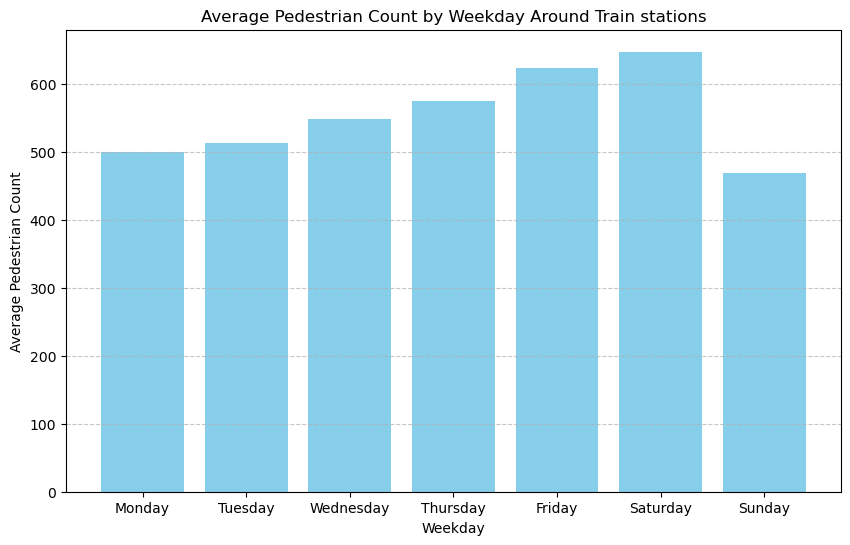

In [53]:
# Add a 'weekday' column
matched_train['weekday'] = pd.to_datetime(matched_train['year_month_day']).dt.day_name()

# Group data by weekend and calculate the avereage peds count
weekday_avg_train = matched_train.groupby('weekday')['pedestrian_count'].mean().reset_index()

# Sort weekdays
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
weekday_avg_train['weekday'] = pd.Categorical(weekday_avg_train['weekday'], categories=weekday_order, ordered=True)
weekday_avg_train = weekday_avg_train.sort_values('weekday')

# Chart
plt.figure(figsize=(10, 6))
plt.bar(weekday_avg_train['weekday'], weekday_avg_train['pedestrian_count'], color='skyblue')
plt.title('Average Pedestrian Count by Weekday Around Train stations')
plt.xlabel('Weekday')
plt.ylabel('Average Pedestrian Count')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

This chart illustrates the average pedestrian count recorded by sensors located within 200 metres of train stations for each hour of the day

# Data Analysis

**Linear Regression**

In [57]:
# Matched_train
# OneHot Encoding for 'weekday'
encoder = OneHotEncoder(sparse=False, drop='first')  
train_weekday_encoded = encoder.fit_transform(matched_train[['weekday']])
weekday_columns_train = encoder.get_feature_names_out(['weekday'])
weekday_encoded_train = pd.DataFrame(train_weekday_encoded, columns=weekday_columns_train)

# Assigning X,y
X = pd.concat([matched_train[['hourday']], weekday_encoded_train], axis=1) 
y = matched_train['pedestrian_count']

# Data split(80:20)
X_train_t_1, X_test_t_1, y_train_t_1, y_test_t_1 = train_test_split(X, y, test_size=0.2, random_state=0)

# Linear regression 
model = LinearRegression()
model.fit(X_train_t_1, y_train_t_1)

# Prediction 
y_pred_t_1 = model.predict(X_test_t_1)

# Results
mse = mean_squared_error(y_test_t_1, y_pred_t_1)
r2 = r2_score(y_test_t_1, y_pred_t_1)

print(f"Mean Squared Error (MSE): {mse}")
print(f"R^2 Score: {r2}")

# Coefficients and intercept 
print(f"Coefficients: {model.coef_}")
print(f"Intercept: {model.intercept_}")

Mean Squared Error (MSE): 557110.7183003942
R^2 Score: 0.10666266212261521
Coefficients: [  39.32759164 -131.01833132    8.50956148 -141.18446176  -62.86497772
 -133.63068267  -93.63317601]
Intercept: 179.8236365351459


The code above uses a linear regression model to analyze the relationship between independent variables (time of day and day of the week) and pedestrian counts for pedestrian data matched with train station data. The resulting MSE value is very high, indicating significant prediction errors, and the low coefficient of determination suggests that the independent variables alone are insufficient to explain pedestrian counts.

In [59]:
# Matched_bus
# OneHot Encoding for 'weekday'
encoder = OneHotEncoder(sparse=False, drop='first')  
bus_weekday_encoded = encoder.fit_transform(matched_bus[['weekday']])
weekday_columns_bus = encoder.get_feature_names_out(['weekday'])
weekday_encoded_bus = pd.DataFrame(bus_weekday_encoded, columns=weekday_columns_bus)

# Assigning X,y
X = pd.concat([matched_bus[['hourday']], weekday_encoded_bus], axis=1) 
y = matched_bus['pedestrian_count']

# Normalization
scaler = MinMaxScaler()
X['hourday'] = scaler.fit_transform(X[['hourday']])

# Data split(80:20)
X_train_b_1, X_test_b_1, y_train_b_1, y_test_b_1 = train_test_split(X, y, test_size=0.2, random_state=0)

# Linear regression 
model = LinearRegression()
model.fit(X_train_b_1, y_train_b_1)

# Prediction 
y_pred_b_1 = model.predict(X_test_b_1)

# Results
mse = mean_squared_error(y_test_b_1, y_pred_b_1)
r2 = r2_score(y_test_b_1, y_pred_b_1)

print(f"Mean Squared Error (MSE): {mse}")
print(f"R^2 Score: {r2}")

# Coefficients and intercept 
print(f"Coefficients: {model.coef_}")
print(f"Intercept: {model.intercept_}")

Mean Squared Error (MSE): 162825.9976517063
R^2 Score: 0.08769979384984072
Coefficients: [399.586215   -74.62204335 -16.19615671 -98.35883181 -23.60598073
 -62.02329336 -40.09834417]
Intercept: 121.25607174570675


The data matched with bus stops also shows similar results, with high MSE values and low coefficient of determination scores

**Random Forest**

In [62]:
# Random Forest_train
# One-Hot Encoding for 'weekday'
encoder = OneHotEncoder(sparse=False, drop='first')  
train_weekday_encoded = encoder.fit_transform(matched_train[['weekday']])
weekday_columns = encoder.get_feature_names_out(['weekday'])
weekday_encoded_df = pd.DataFrame(train_weekday_encoded, columns=weekday_columns)

# Feature Matrix and Target Variable
X = pd.concat([matched_train[['hourday']], weekday_encoded_df], axis=1)
y = matched_train['pedestrian_count']

# Train-Test Split
X_train_t_2, X_test_t_2, y_train_t_2, y_test_t_2 = train_test_split(X, y, test_size=0.3, random_state=0)

# Random Forest Model
rf_model = RandomForestRegressor(n_estimators=300, max_depth=10, random_state=0)
rf_model.fit(X_train_t_2, y_train_t_2)

# Predict
y_pred_rf_t_2 = rf_model.predict(X_test_t_2)

# Evaluate Model
mse_rf = mean_squared_error(y_test_t_2, y_pred_rf_t_2)
r2_rf = r2_score(y_test_t_2, y_pred_rf_t_2)

print(f"Random Forest - Mean Squared Error (MSE): {mse_rf}")
print(f"Random Forest - R^2 Score: {r2_rf}")

# Feature Importance
feature_importances_t = rf_model.feature_importances_
feature_importance_t = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances_t
}).sort_values(by='Importance', ascending=False)


print("\nFeature Importances:")
print(feature_importance_t)


Random Forest - Mean Squared Error (MSE): 509120.4255291889
Random Forest - R^2 Score: 0.20291804858139828

Feature Importances:
             Feature  Importance
0            hourday    0.875408
2   weekday_Saturday    0.053060
3     weekday_Sunday    0.026138
5    weekday_Tuesday    0.013057
1     weekday_Monday    0.011485
4   weekday_Thursday    0.010666
6  weekday_Wednesday    0.010184


The code above uses a random forest model to analyze the relationship between independent variables (time of day and day of the week) and pedestrian counts for data matched with train station locations. The model shows a higher coefficient of determination compared to the linear regression model but still lacks predictive accuracy. Notably, the results confirm that time of day is the most significant variable

In [64]:
# Random Forest_bus
# One-Hot Encoding for 'weekday'
encoder = OneHotEncoder(sparse=False, drop='first')  
bus_weekday_encoded = encoder.fit_transform(matched_bus[['weekday']])
weekday_columns_bus = encoder.get_feature_names_out(['weekday'])
weekday_encoded_bus = pd.DataFrame(bus_weekday_encoded, columns=weekday_columns_bus)

# Feature Matrix and Target Variable
X = pd.concat([matched_bus[['hourday']], weekday_encoded_bus], axis=1)
y = matched_bus['pedestrian_count']

# Train-Test Split
X_train_b_2, X_test_b_2, y_train_b_2, y_test_b_2 = train_test_split(X, y, test_size=0.3, random_state=0)

# Random Forest Model
rf_model = RandomForestRegressor(n_estimators=200, max_depth=15, random_state=0)
rf_model.fit(X_train_b_2, y_train_b_2)

# Predict
y_pred_rf_b_2 = rf_model.predict(X_test_b_2)

# Evaluate Model
mse_rf = mean_squared_error(y_test_b_2, y_pred_rf_b_2)
r2_rf = r2_score(y_test_b_2, y_pred_rf_b_2)

print(f"Random Forest - Mean Squared Error (MSE): {mse_rf}")
print(f"Random Forest - R^2 Score: {r2_rf}")

# Feature Importance
feature_importances_b = rf_model.feature_importances_
feature_importance_b = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances_b
}).sort_values(by='Importance', ascending=False)

print("\nFeature Importances:")
print(feature_importance_b)

Random Forest - Mean Squared Error (MSE): 148978.79356881266
Random Forest - R^2 Score: 0.17820073603411146

Feature Importances:
             Feature  Importance
0            hourday    0.879970
2   weekday_Saturday    0.052511
3     weekday_Sunday    0.030937
1     weekday_Monday    0.010704
5    weekday_Tuesday    0.009743
4   weekday_Thursday    0.009305
6  weekday_Wednesday    0.006830


The data matched with bus stops also shows a similar pattern to the results from the data matched with train stations. It consistently demonstrates that time of day has the most significant impact on predicting pedestrian counts

**Random Forest Result Visualization**

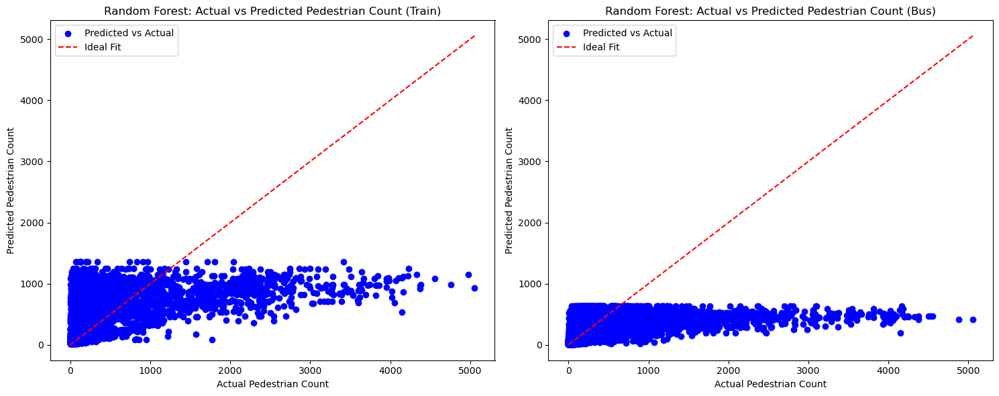

In [125]:
# Visualizing random forest results
fig, axes = plt.subplots(1, 2, figsize=(15, 6))  

# Plot 1: Train data (Random Forest)
axes[0].scatter(y_test_t_2, y_pred_rf_t_2, color='blue', label='Predicted vs Actual')
axes[0].plot([y_test_t_2.min(), y_test_t_2.max()], [y_test_t_2.min(), y_test_t_2.max()], 'k--', color='red', label='Ideal Fit')
axes[0].set_xlabel("Actual Pedestrian Count")  # Corrected method
axes[0].set_ylabel("Predicted Pedestrian Count")  # Corrected method
axes[0].set_title("Random Forest: Actual vs Predicted Pedestrian Count (Train)")  # Corrected method
axes[0].legend()

# Plot 2: Bus data (Random Forest)
axes[1].scatter(y_test_b_2, y_pred_rf_b_2, color='blue', label='Predicted vs Actual')
axes[1].plot([y_test_b_2.min(), y_test_b_2.max()], [y_test_b_2.min(), y_test_b_2.max()], 'k--', color='red', label='Ideal Fit')
axes[1].set_xlabel("Actual Pedestrian Count")  # Corrected method
axes[1].set_ylabel("Predicted Pedestrian Count")  # Corrected method
axes[1].set_title("Random Forest: Actual vs Predicted Pedestrian Count (Bus)")  # Corrected method
axes[1].legend()

# Display the plots
plt.tight_layout() 
plt.show()

The graphs above are scatter plots visualizing the results of the Random Forest model. The significant difference between actual and predicted values in both graphs indicates that the Random Forest model is not accurately predicting pedestrian counts

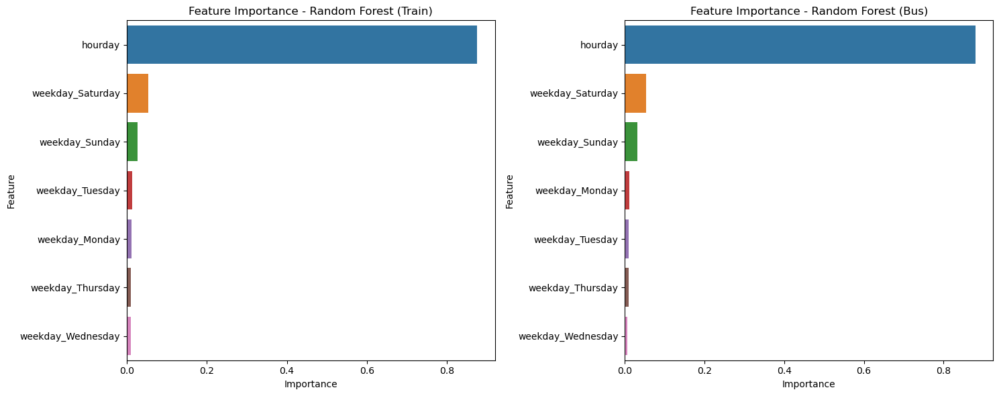

In [67]:
# Feature Importance
fig, axes = plt.subplots(1, 2, figsize=(15, 6))  

# Plot 1: Train data feature importance
sns.barplot(ax=axes[0], x='Importance', y='Feature', data=feature_importance_t)
axes[0].set_title("Feature Importance - Random Forest (Train)")
axes[0].set_xlabel("Importance")
axes[0].set_ylabel("Feature")

# Plot 2: Bus data feature importance
sns.barplot(ax=axes[1], x='Importance', y='Feature', data=feature_importance_b)
axes[1].set_title("Feature Importance - Random Forest (Bus)")
axes[1].set_xlabel("Importance")
axes[1].set_ylabel("Feature")

# Display the plots
plt.tight_layout()
plt.show()

The graphs above are bar plots visualizing the feature importance used in the Random Forest model. Both datasets consistently show that time of day is the most significant variable

In [69]:
# Checking correlations
correlation_t = matched_train['hourday'].corr(matched_train['pedestrian_count'])
print(f"Correlation between hourday and pedestrian count (Train): {correlation_t}")

correlation_b = matched_bus['hourday'].corr(matched_bus['pedestrian_count'])
print(f"Correlation between hourday and pedestrian count (Bus): {correlation_b}")

Correlation between hourday and pedestrian count (Train): 0.33098737131482014
Correlation between hourday and pedestrian count (Bus): 0.27666426266332983


After analyzing the feature importance of the Random Forest model, I analyzed the correlation between time of day and pedestrian count for both datasets. The results show a weak positive correlation in both cases

## Conclusion

**Findings**

This analysis was conducted based on pedestrian activity data within 200 metres of train stations and bus stops to assume a relationship between pedestrian activity and public transport demand. The results demonstrated that hourday (time of day) significantly influences pedestrian activity. The Random Forest analysis highlighted hourday as the most important feature, indicating that pedestrian activity is concentrated during specific times of the day, such as rush hours. Additionally, the visualization of pedestrian counts by hour revealed clear patterns of increased activity at certain times (16:00 - 18:00), emphasizing the importance of time as a critical factor for analyzing public transport demand.

**Limitations**

There are several limitations due to constraints in the available data. While pedestrian sensor data was used to indirectly estimate public transport demand, the analysis does not include data confirming whether the recorded pedestrians actually used public transport. This limits the ability to establish a direct relationship between pedestrian counts and public transport usage. Moreover, this use case relied only on time of day and day of the week as explanatory variables, excluding other significant factors such as weather, events, or population density. These factors could significantly influence public transport demand and their exclusion may reduce the model's accuracy and predictive power.

In conclusion, while the analysis is limited in its ability to fully explain or predict public transport demand due to data constraints, it provides meaningful insights by confirming the significance of time of day as a key factor in understanding pedestrian activity and public transport demand.

## References

[1] City of Melbourne. (2024). Transport strategy 2030. Available at https://www.melbourne.vic.gov.au/transport-strategy-2030